In [ ]:
!pip install segmentation_models_pytorch albumentations pycocotools


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.8/154.8 kB 7.8 MB/s eta 0:00:00


In [ ]:
!pip install torch torchvision torchaudio
!pip install opencv-python matplotlib tqdm


In [ ]:
# Mount Google Drive to access files
from google.colab import drive
drive.mount('/content/drive')

import os
import zipfile

# Path to the ZIP file stored in Google Drive
zip_path = "/content/drive/MyDrive/RMDS_Segmentation_Assignment.zip"
# Folder where the dataset will be extracted
dataset_dir = "/content/dataset"

# Extract the dataset only if it hasn't been extracted already
if not os.path.exists(dataset_dir):
    os.makedirs(dataset_dir, exist_ok=True)
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(dataset_dir)
    print("Dataset extracted successfully.")
else:
    print("Dataset folder already exists, skipping extraction.")

# List the contents of the extracted folder to verify structure
print("Extracted folder contents:", os.listdir(dataset_dir))

# Set the root directory for the dataset
root_dir = dataset_dir

# Define paths for training and validation images and annotation files
train_images = os.path.join(root_dir, "train-300", "images")
val_images   = os.path.join(root_dir, "validation-300", "images")
train_json   = os.path.join(root_dir, "train-300", "labels.json")
val_json     = os.path.join(root_dir, "validation-300", "labels.json")

# Print the paths to make sure they are correct
print("Training images path:", train_images)
print("Validation images path:", val_images)
print("Training labels JSON:", train_json)
print("Validation labels JSON:", val_json)

Mounted at /content/drive
Dataset extracted successfully.
Extracted folder contents: ['validation-300', 'test-30', 'train-300', '__MACOSX']
Training images path: /content/dataset/train-300/images
Validation images path: /content/dataset/validation-300/images
Training labels JSON: /content/dataset/train-300/labels.json
Validation labels JSON: /content/dataset/validation-300/labels.json


# EDA

In [ ]:
from pycocotools.coco import COCO
import json

# Classes we want to keep in the filtered dataset
TARGET_CLASSES = ["person", "cat", "sports ball", "book"]

def filter_coco_json(input_file, output_file, classes):
    # Load the original COCO annotations
    coco = COCO(input_file)

    # Get category IDs for the selected classes
    cat_ids = coco.getCatIds(catNms=classes)

    # Get all image IDs that contain the selected categories
    img_ids = list({img_id for cat_id in cat_ids for img_id in coco.getImgIds(catIds=[cat_id])})

    # Load the image and annotation information
    images = [coco.loadImgs(img_id)[0] for img_id in img_ids]
    ann_ids = coco.getAnnIds(imgIds=img_ids, catIds=cat_ids, iscrowd=None)
    annotations = coco.loadAnns(ann_ids)

    # Build filtered COCO style JSON
    filtered_data = {
        "images": images,
        "annotations": annotations,
        "categories": coco.loadCats(cat_ids)
    }

    # Save the filtered JSON to disk
    with open(output_file, "w") as f:
        json.dump(filtered_data, f)

    print(f"Filtered annotations saved to: {output_file}")
    print(f"Total images: {len(images)} | Total annotations: {len(annotations)}")

# Paths to save filtered JSONs
train_filtered_json = "/content/dataset/train_filtered.json"
val_filtered_json   = "/content/dataset/val_filtered.json"

# Apply filtering using the dataset variables defined earlier
filter_coco_json(train_json, train_filtered_json, TARGET_CLASSES)
filter_coco_json(val_json, val_filtered_json, TARGET_CLASSES)

loading annotations into memory...
Done (t=0.04s)
creating index...
index created!
Filtered annotations saved to: /content/dataset/train_filtered.json
Total images: 300 | Total annotations: 1310
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
Filtered annotations saved to: /content/dataset/val_filtered.json
Total images: 300 | Total annotations: 1213


Class distribution:
 name
sports ball      18
cat              27
book            128
person         1137
Name: count, dtype: int64


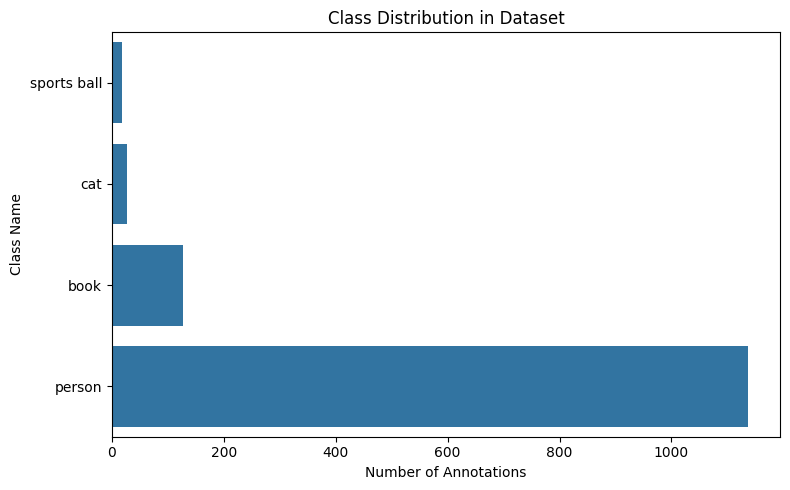

In [ ]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_class_distribution(json_path):
    with open(json_path, "r") as f:
        data = json.load(f)

    annotations = pd.DataFrame(data["annotations"])
    categories = pd.DataFrame(data["categories"])

    # Merge to attach category names
    merged = annotations.merge(categories, left_on="category_id", right_on="id")

    class_counts = merged["name"].value_counts().sort_values()

    print("Class distribution:\n", class_counts)

    plt.figure(figsize=(8, 5))
    sns.barplot(x=class_counts.values, y=class_counts.index)

    plt.xlabel("Number of Annotations")
    plt.ylabel("Class Name")
    plt.title("Class Distribution in Dataset")
    plt.tight_layout()
    plt.show()


plot_class_distribution("/content/dataset/train_filtered.json")



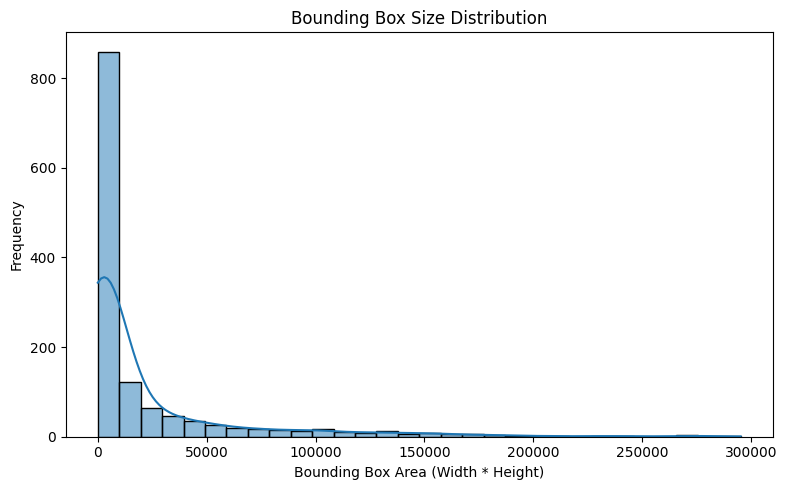

In [ ]:
import numpy as np

def plot_bbox_size_distribution(json_path):
    with open(json_path, "r") as f:
        data = json.load(f)

    annotations = pd.DataFrame(data["annotations"])

    # Calculate the area of the bounding boxes (width * height)
    annotations["bbox_area"] = annotations["bbox"].apply(lambda x: x[2] * x[3])

    # Plot the distribution of bounding box sizes
    plt.figure(figsize=(8, 5))
    sns.histplot(annotations["bbox_area"], kde=True, bins=30)
    plt.xlabel("Bounding Box Area (Width * Height)")
    plt.ylabel("Frequency")
    plt.title("Bounding Box Size Distribution")
    plt.tight_layout()
    plt.show()

# Use the filtered dataset
plot_bbox_size_distribution("/content/dataset/train_filtered.json")


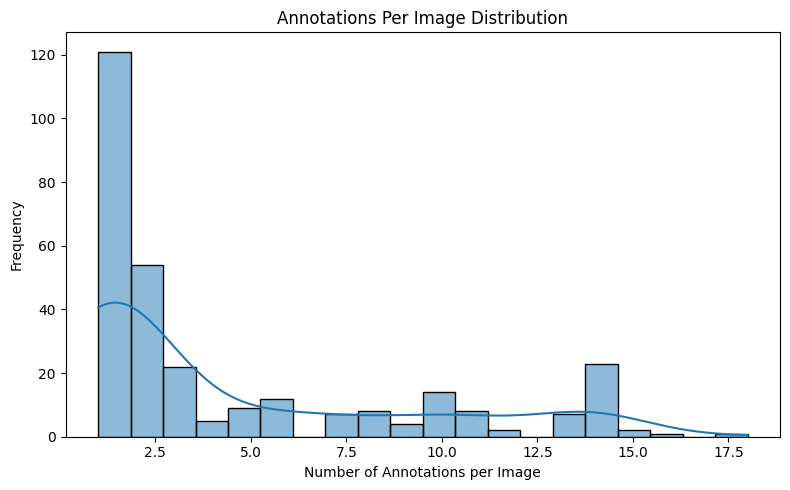

In [ ]:
def plot_annotations_per_image(json_path):
    with open(json_path, "r") as f:
        data = json.load(f)

    annotations = pd.DataFrame(data["annotations"])

    # Get number of annotations per image
    img_ann_counts = annotations.groupby("image_id").size()

    # Plot the distribution
    plt.figure(figsize=(8, 5))
    sns.histplot(img_ann_counts, kde=True, bins=20)
    plt.xlabel("Number of Annotations per Image")
    plt.ylabel("Frequency")
    plt.title("Annotations Per Image Distribution")
    plt.tight_layout()
    plt.show()

# Use the filtered dataset
plot_annotations_per_image("/content/dataset/train_filtered.json")


loading annotations into memory...
Done (t=0.11s)
creating index...
index created!


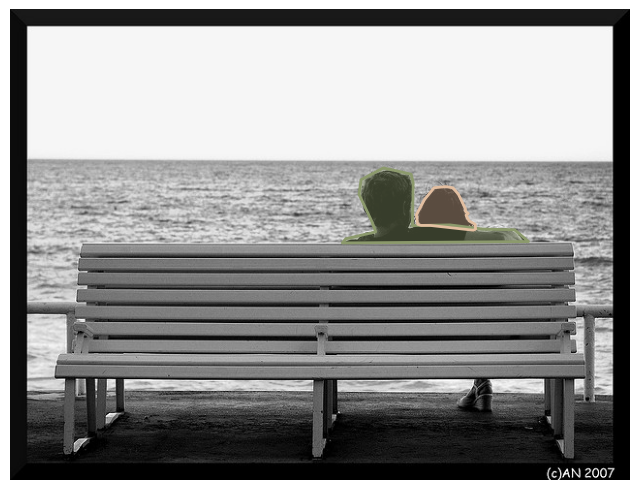

In [ ]:
import random
from pycocotools.coco import COCO
import cv2
import matplotlib.pyplot as plt

def show_random_sample(json_path, img_folder):
    coco = COCO(json_path)

    img_ids = coco.getImgIds()
    img_id = random.choice(img_ids)
    img_meta = coco.loadImgs(img_id)[0]

    img_path = f"{img_folder}/{img_meta['file_name']}"
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(8,8))
    plt.imshow(img)

    ann_ids = coco.getAnnIds(imgIds=[img_id])
    anns = coco.loadAnns(ann_ids)

    coco.showAnns(anns)
    plt.axis("off")
    plt.show()


show_random_sample(
    "/content/dataset/train_filtered.json",
    "/content/dataset/train-300/data"
)



loading annotations into memory...
Done (t=0.06s)
creating index...
index created!


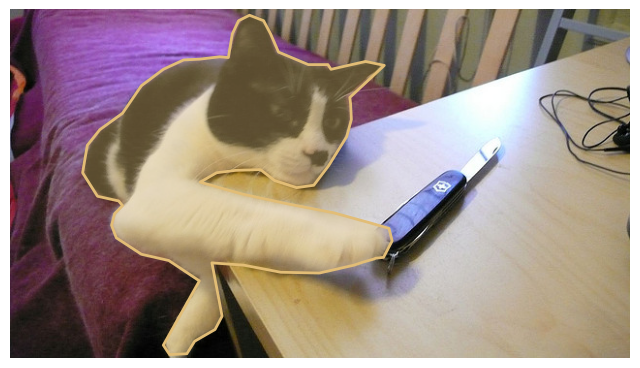

In [ ]:
show_random_sample(
    "/content/dataset/train_filtered.json",
    "/content/dataset/train-300/data"
)


# Segnet sementic Model

Device: cuda
loading annotations into memory...
Done (t=0.04s)
creating index...
index created!
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
Train images: 300
Val images: 300


/usr/local/lib/python3.12/dist-packages/albumentations/core/validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Computing class weights from training masks (this may take a moment)...
Class weights: [0.01621519 0.09004024 0.8971015  2.590872   1.4057709 ]


/tmp/ipython-input-682782308.py:292: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = torch.cuda.amp.GradScaler(enabled=(DEVICE=="cuda"))
/tmp/ipython-input-682782308.py:327: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(DEVICE=="cuda")):
/tmp/ipython-input-682782308.py:348: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(DEVICE=="cuda")):


Epoch 1/80 - Train: 2.0375  Val: 1.8898  mIoU: 0.3281
✔ Saved best model (mIoU 0.3281)
Epoch 2/80 - Train: 1.8673  Val: 1.9258  mIoU: 0.3010
Epoch 3/80 - Train: 1.6825  Val: 1.5220  mIoU: 0.3170
Epoch 4/80 - Train: 1.5881  Val: 1.4730  mIoU: 0.4098
✔ Saved best model (mIoU 0.4098)
Epoch 5/80 - Train: 1.5077  Val: 1.3979  mIoU: 0.3847
Epoch 6/80 - Train: 1.3302  Val: 1.8685  mIoU: 0.3987
Epoch 7/80 - Train: 1.3952  Val: 1.5605  mIoU: 0.4326
✔ Saved best model (mIoU 0.4326)
Epoch 8/80 - Train: 1.3961  Val: 1.3632  mIoU: 0.4387
✔ Saved best model (mIoU 0.4387)
Epoch 9/80 - Train: 1.3128  Val: 1.3353  mIoU: 0.4806
✔ Saved best model (mIoU 0.4806)
Epoch 10/80 - Train: 1.2477  Val: 1.3250  mIoU: 0.4298
Epoch 11/80 - Train: 1.3016  Val: 1.5028  mIoU: 0.4884
✔ Saved best model (mIoU 0.4884)
Epoch 12/80 - Train: 1.2401  Val: 1.5126  mIoU: 0.4248
Epoch 13/80 - Train: 1.2178  Val: 1.5402  mIoU: 0.4808
Epoch 14/80 - Train: 1.3223  Val: 1.3525  mIoU: 0.4669
Epoch 15/80 - Train: 1.2563  Val: 1.4453 

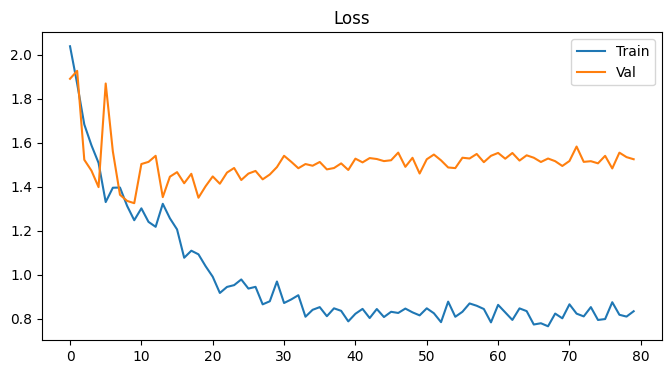

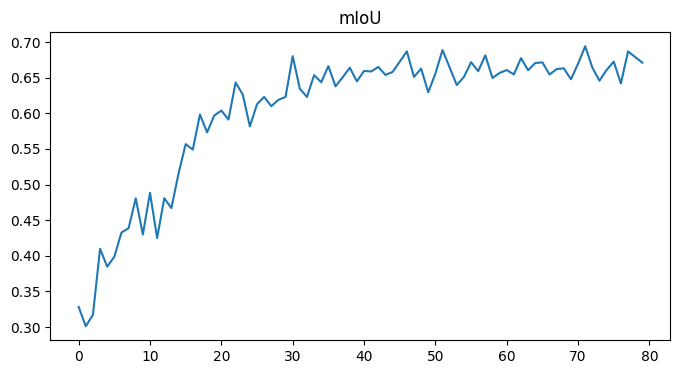

Loaded best: /content/drive/MyDrive/SegNet_Improved_Output/segnet_vgg16_improved_best.pth
Saving predictions for 30 images to /content/drive/MyDrive/SegNet_Improved_Output/preds ...
Done.


In [ ]:
import os
from glob import glob
from collections import Counter

import cv2
import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim

import torchvision
from torchvision import models

from pycocotools.coco import COCO
import albumentations as A
from albumentations.pytorch import ToTensorV2
import segmentation_models_pytorch as smp


# Config

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print("Device:", DEVICE)

IMG_SIZE = 256
IMG_HEIGHT = IMG_WIDTH = IMG_SIZE
BATCH_SIZE = 8
LR = 1e-4
EPOCHS = 80
NUM_WORKERS = 2
PIN_MEMORY = True

SAVE_DIR = "/content/drive/MyDrive/SegNet_Improved_Output"
os.makedirs(SAVE_DIR, exist_ok=True)
PRED_DIR = os.path.join(SAVE_DIR, "preds")
os.makedirs(PRED_DIR, exist_ok=True)

TRAIN_IMAGES_DIR = "/content/dataset/train-300/data"
VAL_IMAGES_DIR   = "/content/dataset/validation-300/data"
TEST_IMAGES_DIR  = "/content/dataset/test-30"

TRAIN_JSON = "/content/dataset/train-300/labels.json"
VAL_JSON   = "/content/dataset/validation-300/labels.json"

NUM_CLASSES = 5

CLASS_COLORS = {
    0: (0, 0, 0),
    1: (255, 0, 0),
    2: (0, 255, 0),
    3: (0, 0, 255),
    4: (255, 255, 0)
}

COCO_TO_CLASS = {
    1: 1,    # person
    17: 2,   # cat
    37: 3,   # sports ball
    84: 4    # book
}


# Transforms

train_transform = A.Compose([
    A.Resize(IMG_HEIGHT, IMG_WIDTH),
    A.HorizontalFlip(p=0.5),
    A.ShiftScaleRotate(shift_limit=0.06, scale_limit=0.1, rotate_limit=10, p=0.5, border_mode=cv2.BORDER_REFLECT),
    A.RandomBrightnessContrast(p=0.5),
    A.GaussNoise(p=0.2),
    A.Normalize(mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225)),
    ToTensorV2()
])

val_transform = A.Compose([
    A.Resize(IMG_HEIGHT, IMG_WIDTH),
    A.Normalize(mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225)),
    ToTensorV2()
])


# Dataset (COCO-style)

class COCOSegDataset(Dataset):
    def __init__(self, img_dir, ann_file, transforms):
        self.img_dir = img_dir
        self.coco = COCO(ann_file)
        self.transforms = transforms

        all_ids = sorted(self.coco.getImgIds())
        self.id_to_file = {img["id"]: img["file_name"] for img in self.coco.loadImgs(all_ids)}

        self.img_ids = []
        for img_id in all_ids:
            anns = self.coco.loadAnns(self.coco.getAnnIds(img_id))
            has_target = False
            for a in anns:
                cid = a["category_id"]
                if cid in COCO_TO_CLASS or (0 <= cid < NUM_CLASSES):
                    has_target = True
                    break
            if has_target:
                self.img_ids.append(img_id)

    def __len__(self):
        return len(self.img_ids)

    def _resolve_class(self, cid):
        if 0 <= cid < NUM_CLASSES:
            return int(cid)
        return int(COCO_TO_CLASS.get(cid, 0))

    def __getitem__(self, idx):
        img_id = self.img_ids[idx]
        fname = self.id_to_file[img_id]
        path = os.path.join(self.img_dir, fname)

        image = cv2.imread(path)
        if image is None:
            raise FileNotFoundError(path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h, w = image.shape[:2]

        mask = np.zeros((h, w), dtype=np.uint8)
        anns = self.coco.loadAnns(self.coco.getAnnIds(img_id))
        for ann in anns:
            ann_mask = self.coco.annToMask(ann)
            if ann_mask is None:
                continue
            cls = self._resolve_class(ann["category_id"])
            mask[ann_mask == 1] = cls

        augmented = self.transforms(image=image, mask=mask)
        img_t = augmented["image"]
        mask_t = augmented["mask"].long()
        return img_t, mask_t, fname


# Dataloaders

train_ds = COCOSegDataset(TRAIN_IMAGES_DIR, TRAIN_JSON, transforms=train_transform)
val_ds   = COCOSegDataset(VAL_IMAGES_DIR,   VAL_JSON,   transforms=val_transform)

train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS, pin_memory=PIN_MEMORY)
val_loader   = DataLoader(val_ds,   batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=PIN_MEMORY)

print("Train images:", len(train_ds))
print("Val images:", len(val_ds))

#Model: SegNet VGG16 pretrained/skip connections

class ConvReluBN(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Conv2d(in_ch, out_ch, kernel_size=3, padding=1)
        self.bn = nn.BatchNorm2d(out_ch)
        self.relu = nn.ReLU(inplace=True)
    def forward(self, x):
        return self.relu(self.bn(self.conv(x)))

class SegNetVGG16Skip(nn.Module):
    """
    VGG16 pretrained encoder + decoder with skip connections (concatenate).
    This is a U-Net-like decoder built on top of VGG features (SegNet-style).
    """
    def __init__(self, num_classes=5, pretrained=True, freeze_encoder=False):
        super().__init__()
        vgg = models.vgg16_bn(pretrained=pretrained)
        features = list(vgg.features.children())

        # split features into encoder blocks at MaxPool layers
        self.encoder_blocks = nn.ModuleList()
        cur_block = []
        for layer in features:
            cur_block.append(layer)
            if isinstance(layer, nn.MaxPool2d):
                self.encoder_blocks.append(nn.Sequential(*cur_block))
                cur_block = []
        if len(cur_block) > 0:
            self.encoder_blocks.append(nn.Sequential(*cur_block))

        # Expected encoder channels
        enc_ch = [64, 128, 256, 512, 512]

        # Decoder: mirror with concatenation (so input channels double when concatenated)
        self.dec5 = nn.Sequential(
            ConvReluBN(enc_ch[4] + enc_ch[3], 512),
            ConvReluBN(512, 512),
            ConvReluBN(512, 256),
        )
        self.dec4 = nn.Sequential(
            ConvReluBN(256 + enc_ch[2], 256),
            ConvReluBN(256, 256),
            ConvReluBN(256, 128),
        )
        self.dec3 = nn.Sequential(
            ConvReluBN(128 + enc_ch[1], 128),
            ConvReluBN(128, 128),
            ConvReluBN(128, 64),
        )
        self.dec2 = nn.Sequential(
            ConvReluBN(64 + enc_ch[0], 64),
            ConvReluBN(64, 64),
        )
        self.final = nn.Conv2d(64, num_classes, kernel_size=1)

        if freeze_encoder:
            for param in self.encoder_blocks.parameters():
                param.requires_grad = False

    def forward(self, x):
        feats = []
        out = x
        # encoder: collect outputs (before pooling)
        for block in self.encoder_blocks:
            out = block(out)
            feats.append(out)

        # start from last feature
        x = feats[-1]   # [B, 512, H/32, W/32]

        # upsample and concat with encoder features (skip)
        x = F.interpolate(x, scale_factor=2, mode='bilinear', align_corners=False)
        x = torch.cat([x, feats[-2]], dim=1)
        x = self.dec5(x)

        x = F.interpolate(x, scale_factor=2, mode='bilinear', align_corners=False)
        x = torch.cat([x, feats[-3]], dim=1)
        x = self.dec4(x)

        x = F.interpolate(x, scale_factor=2, mode='bilinear', align_corners=False)
        x = torch.cat([x, feats[-4]], dim=1)
        x = self.dec3(x)

        x = F.interpolate(x, scale_factor=2, mode='bilinear', align_corners=False)
        x = torch.cat([x, feats[-5]], dim=1)
        x = self.dec2(x)

        x = F.interpolate(x, scale_factor=2, mode='bilinear', align_corners=False)
        x = self.final(x)
        return x

# create model
model = SegNetVGG16Skip(num_classes=NUM_CLASSES, pretrained=True, freeze_encoder=False).to(DEVICE)


# Compute class weights from training masks (pixel-wise)

def compute_class_weights(dataset, num_classes=NUM_CLASSES, samples=None):
    """
    Count pixels per class across the dataset (on resized masks).
    If samples is provided, uses first `samples` images (to save time).
    Returns weights inversely proportional to frequency.
    """
    counts = np.zeros(num_classes, dtype=np.float64)
    n = len(dataset) if samples is None else min(samples, len(dataset))
    for i in range(n):
        _, mask, _ = dataset[i]
        # mask is torch tensor (H,W)
        vals, c = np.unique(mask.numpy(), return_counts=True)
        for v, cnt in zip(vals, c):
            if 0 <= v < num_classes:
                counts[int(v)] += cnt
    # avoid zeros
    counts = np.maximum(counts, 1.0)
    freq = counts / counts.sum()
    # weight = 1 / freq (normalize)
    weights = 1.0 / freq
    weights = weights / weights.mean()
    return torch.tensor(weights, dtype=torch.float32)

print("Computing class weights from training masks (this may take a moment)...")
class_weights = compute_class_weights(train_ds, samples=None)
class_weights = class_weights.to(DEVICE)
print("Class weights:", class_weights.cpu().numpy())


# Loss, optimizer, scheduler, amp scaler

dice = smp.losses.DiceLoss(mode="multiclass")
ce = nn.CrossEntropyLoss(weight=class_weights)
def combined_loss(logits, targets):
    return dice(logits, targets) + ce(logits, targets)

optimizer = torch.optim.AdamW(model.parameters(), lr=LR, weight_decay=1e-4)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="min", patience=4, factor=0.5)

scaler = torch.cuda.amp.GradScaler(enabled=(DEVICE=="cuda"))


# IoU helper

def iou_score(pred, mask, num_classes=NUM_CLASSES):
    pred = pred.flatten()
    mask = mask.flatten()
    ious = []
    for c in range(num_classes):
        p = pred == c
        g = mask == c
        inter = (p & g).sum()
        union = (p | g).sum()
        if union == 0:
            ious.append(1.0)
        else:
            ious.append(float(inter) / (union + 1e-6))
    return np.mean(ious)

# Training loop (mixed precision)

history = {"train_loss": [], "val_loss": [], "miou": []}
best_miou = 0.0

for epoch in range(1, EPOCHS + 1):
    model.train()
    train_loss = 0.0

    for imgs, masks, _ in train_loader:
        imgs = imgs.to(DEVICE)
        masks = masks.to(DEVICE)

        optimizer.zero_grad()
        with torch.cuda.amp.autocast(enabled=(DEVICE=="cuda")):
            logits = model(imgs)
            loss = combined_loss(logits, masks)

        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        train_loss += loss.item()

    train_loss /= max(1, len(train_loader))

    # validation
    model.eval()
    val_loss = 0.0
    miou = 0.0

    with torch.no_grad():
        for imgs, masks, _ in val_loader:
            imgs = imgs.to(DEVICE)
            masks = masks.to(DEVICE)
            with torch.cuda.amp.autocast(enabled=(DEVICE=="cuda")):
                logits = model(imgs)
                loss = combined_loss(logits, masks)
            val_loss += loss.item()

            preds = torch.argmax(logits, dim=1).cpu().numpy()
            gts = masks.cpu().numpy()
            for p, g in zip(preds, gts):
                miou += iou_score(p, g)

    val_loss /= max(1, len(val_loader))
    miou /= max(1, len(val_ds))

    history["train_loss"].append(train_loss)
    history["val_loss"].append(val_loss)
    history["miou"].append(miou)

    print(f"Epoch {epoch}/{EPOCHS} - Train: {train_loss:.4f}  Val: {val_loss:.4f}  mIoU: {miou:.4f}")

    scheduler.step(val_loss)

    if miou > best_miou:
        best_miou = miou
        torch.save(model.state_dict(), os.path.join(SAVE_DIR, "segnet_vgg16_improved_best.pth"))
        print("✔ Saved best model (mIoU {:.4f})".format(best_miou))


# Plots

plt.figure(figsize=(8,4))
plt.plot(history["train_loss"], label="Train")
plt.plot(history["val_loss"], label="Val")
plt.legend(); plt.title("Loss")
plt.savefig(os.path.join(SAVE_DIR, "loss.png"))
plt.show()

plt.figure(figsize=(8,4))
plt.plot(history["miou"])
plt.title("mIoU")
plt.savefig(os.path.join(SAVE_DIR, "miou.png"))
plt.show()


# Inference / save predictions (all test images)

best_fp = os.path.join(SAVE_DIR, "segnet_vgg16_improved_best.pth")
if os.path.exists(best_fp):
    model.load_state_dict(torch.load(best_fp, map_location=DEVICE))
    print("Loaded best:", best_fp)
else:
    print("No saved best found; using current weights.")

def save_prediction(img_path, save_dir=PRED_DIR):
    fname = os.path.basename(img_path)
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    H, W = img_rgb.shape[:2]
    aug = val_transform(image=img_rgb)
    img_t = aug["image"].unsqueeze(0).to(DEVICE)

    with torch.no_grad():
        logits = model(img_t)
        pred = torch.argmax(logits, dim=1).squeeze().cpu().numpy()

    pred_up = cv2.resize(pred, (W, H), interpolation=cv2.INTER_NEAREST)

    # color mask
    color = np.zeros((H, W, 3), dtype=np.uint8)
    for c, col in CLASS_COLORS.items():
        color[pred_up == c] = col

    overlay = (0.5 * img_rgb + 0.5 * color).astype(np.uint8)

    # Save three images: original, mask, overlay
    cv2.imwrite(os.path.join(save_dir, fname.replace('.', '_orig.')), cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(save_dir, fname.replace('.', '_mask.')), cv2.cvtColor(color, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(save_dir, fname.replace('.', '_overlay.')), cv2.cvtColor(overlay, cv2.COLOR_RGB2BGR))


# run on all test images
test_files = glob(f"{TEST_IMAGES_DIR}/*.jpg") + glob(f"{TEST_IMAGES_DIR}/*.png")
print(f"Saving predictions for {len(test_files)} images to {PRED_DIR} ...")
for fp in test_files:
    save_prediction(fp)

print("Done.")

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from glob import glob
import os

TEST_DIR = "/content/dataset/test-30"
PRED_DIR = "/content/drive/MyDrive/SegNet_Improved_Output/preds"

# your class colors (same as training)
CLASS_COLORS = {
    0: (0, 0, 0),
    1: (255, 255, 0),
    2: (0, 255, 0),
    3: (255, 0, 255),
    4: (0, 255, 255),
}

def show_results(index):
    # load test images (sorted order)
    test_files = sorted(glob(f"{TEST_DIR}/*.jpg") + glob(f"{TEST_DIR}/*.png"))

    if index >= len(test_files):
        print("Index out of range")
        return

    img_path = test_files[index]

    # Load original image
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    # Load predicted mask
    pred_path = os.path.join(PRED_DIR, f"pred_{index}.png")
    pred_mask = cv2.imread(pred_path, cv2.IMREAD_GRAYSCALE)

    # Colorize prediction
    H, W = pred_mask.shape
    color_mask = np.zeros((H, W, 3), dtype=np.uint8)

    for c, col in CLASS_COLORS.items():
        color_mask[pred_mask == c] = col

    overlay = (0.5 * img_rgb + 0.5 * color_mask).astype(np.uint8)

    # Plot
    plt.figure(figsize=(16,5))
    plt.subplot(1,3,1); plt.imshow(img_rgb); plt.title("Original Image"); plt.axis("off")
    plt.subplot(1,3,2); plt.imshow(color_mask); plt.title("Predicted Mask"); plt.axis("off")
    plt.subplot(1,3,3); plt.imshow(overlay); plt.title("Overlay"); plt.axis("off")
    plt.show()

print(" Ready! Use: show_results(0), show_results(1), ...")


✔ Ready! Use: show_results(0), show_results(1), ...


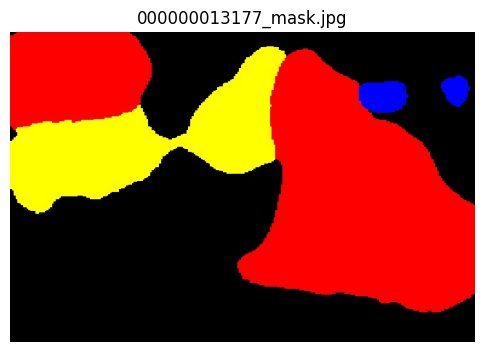

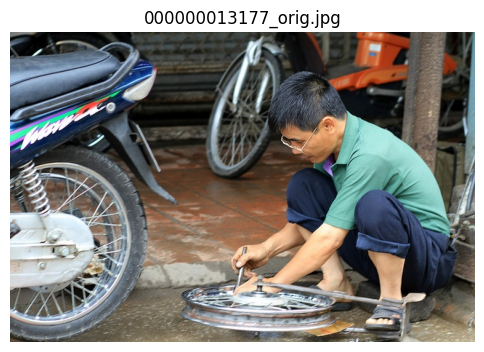

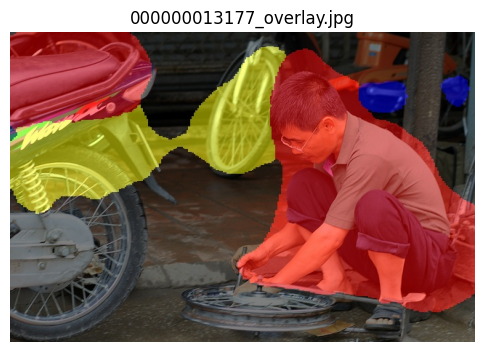

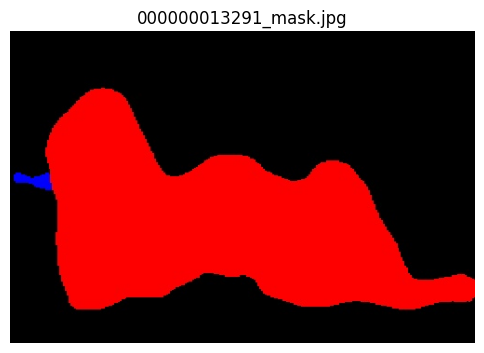

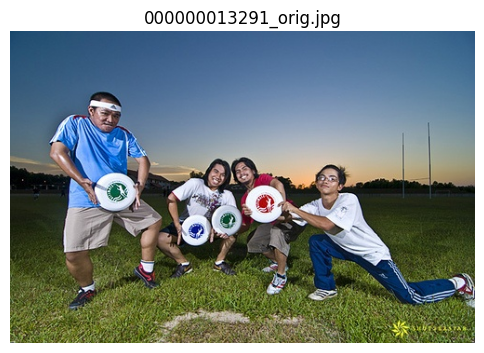

...

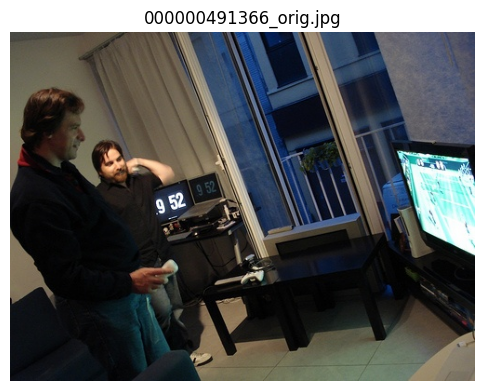

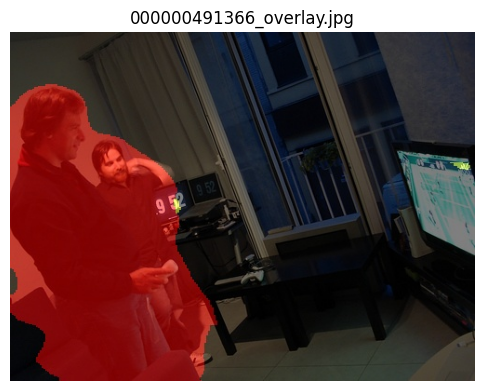

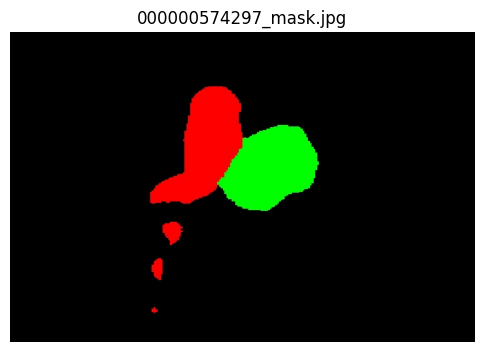

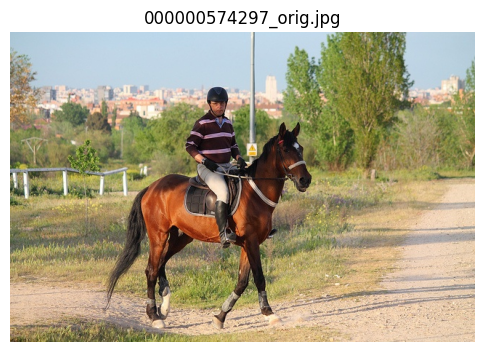

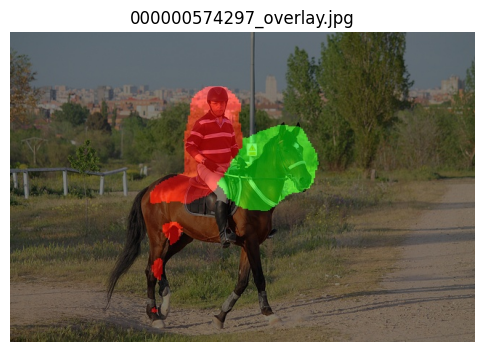

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image

pred_dir = "/content/drive/MyDrive/SegNet_Improved_Output/preds"

# List image files
files = sorted([f for f in os.listdir(pred_dir) if f.endswith(('.png', '.jpg'))])

# Show images
for f in files:
    img = Image.open(os.path.join(pred_dir, f))
    plt.figure(figsize=(6,6))
    plt.imshow(img)
    plt.title(f)
    plt.axis('off')
    plt.show()


# Testing on Test Images

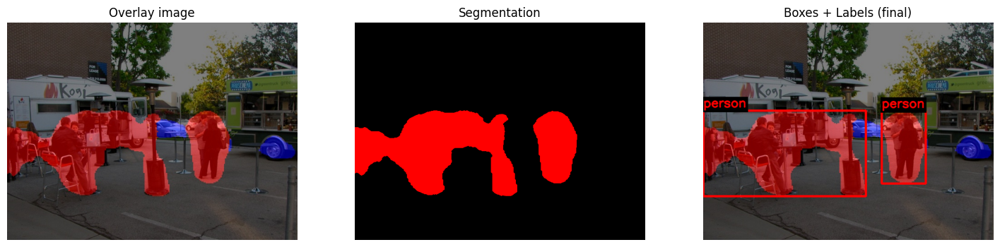

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


overlay_path = "/content/drive/MyDrive/SegNet_Improved_Output/preds/000000153011_overlay.jpg"


MIN_AREA_RATIO = 0.001
MORPH_KERNEL = 7
NMS_IOU_THRESH = 0.3
LABEL = "person"


def get_red_mask(img):
    """Return a binary mask for red regions robust to semi-transparent overlays."""
    r = img[:,:,0].astype(int)
    g = img[:,:,1].astype(int)
    b = img[:,:,2].astype(int)
    mask = (r > 120) & (r > g + 30) & (r > b + 30)
    return mask.astype(np.uint8) * 255

def non_max_suppression(boxes, scores=None, iou_thresh=0.3):
    """Simple NMS for bounding boxes (xywh). Returns kept boxes."""
    if len(boxes) == 0:
        return []
    boxes_xy = np.array([[x, y, x+w, y+h] for (x,y,w,h) in boxes], dtype=float)
    x1 = boxes_xy[:,0]; y1 = boxes_xy[:,1]; x2 = boxes_xy[:,2]; y2 = boxes_xy[:,3]
    areas = (x2-x1+1) * (y2-y1+1)
    order = np.arange(len(boxes)) if scores is None else np.argsort(scores)[::-1]
    keep = []
    while order.size > 0:
        i = order[0]
        keep.append(i)
        xx1 = np.maximum(x1[i], x1[order[1:]])
        yy1 = np.maximum(y1[i], y1[order[1:]])
        xx2 = np.minimum(x2[i], x2[order[1:]])
        yy2 = np.minimum(y2[i], y2[order[1:]])
        w = np.maximum(0.0, xx2-xx1+1)
        h = np.maximum(0.0, yy2-yy1+1)
        inter = w*h
        iou = inter / (areas[i] + areas[order[1:]] - inter)
        inds = np.where(iou <= iou_thresh)[0]
        order = order[inds + 1]
    return [boxes[i] for i in keep]

# Load image
overlay_bgr = cv2.imread(overlay_path)
if overlay_bgr is None:
    raise FileNotFoundError(f"File not found: {overlay_path}")
overlay = cv2.cvtColor(overlay_bgr, cv2.COLOR_BGR2RGB)

h, w = overlay.shape[:2]
img_area = h * w

# Create binary mask
mask = get_red_mask(overlay)

# Morphology clean-up
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (MORPH_KERNEL, MORPH_KERNEL))
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

# Find contours
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Filter contours
boxes = []
for cnt in contours:
    area = cv2.contourArea(cnt)
    if area < (MIN_AREA_RATIO * img_area):
        continue
    x, y, bw, bh = cv2.boundingRect(cnt)
    boxes.append((x, y, bw, bh))

# NMS to merge overlaps
boxes = non_max_suppression(boxes, iou_thresh=NMS_IOU_THRESH)

# Draw boxes + labels
output = overlay.copy()
for (x, y, bw, bh) in boxes:
    x1, y1, x2, y2 = x, y, x + bw, y + bh
    color = (255, 0, 0)

    cv2.rectangle(output, (x1, y1), (x2, y2), color, 3)

    font = cv2.FONT_HERSHEY_SIMPLEX
    scale = 0.9
    thickness = 2
    (tw, th), baseline = cv2.getTextSize(LABEL, font, scale, thickness)

    tx = x1
    ty = y1 - 8
    if ty - th < 0:
        ty = y1 + th + 8

    cv2.rectangle(output, (tx-2, ty-th-2), (tx+tw+2, ty+baseline+2), (0,0,0), -1)
    cv2.putText(output, LABEL, (tx, ty), font, scale, color, thickness, cv2.LINE_AA)

mask_red = np.zeros_like(overlay)
mask_red[:,:,0] = mask


# Show images
plt.figure(figsize=(18,6))

plt.subplot(1,3,1)
plt.title("Overlay image")
plt.imshow(overlay)
plt.axis('off')

plt.subplot(1,3,2)
plt.title("Segmentation")
plt.imshow(mask_red)
plt.axis('off')

plt.subplot(1,3,3)
plt.title("Boxes + Labels (final)")
plt.imshow(output)
plt.axis('off')

plt.show()




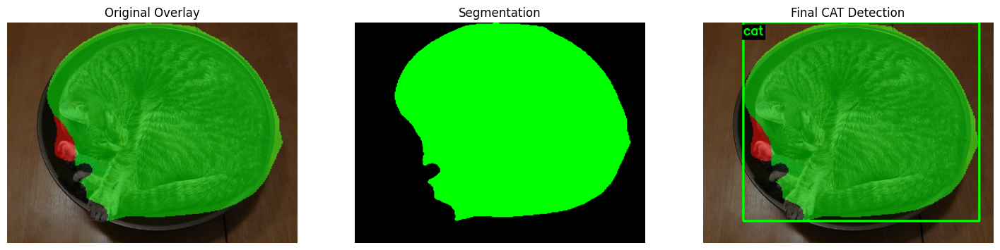

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


overlay_path = "/content/drive/MyDrive/SegNet_Improved_Output/preds/000000125850_overlay.jpg"

LABEL = "cat"
MIN_AREA_RATIO = 0.001
MORPH_KERNEL = 7
NMS_IOU_THRESH = 0.3


def get_green_mask(img):
    """
    Detect green regions (your cat mask).
    Works for both solid + semi-transparent green overlays.
    """
    r = img[:,:,0].astype(int)
    g = img[:,:,1].astype(int)
    b = img[:,:,2].astype(int)

    # Green stronger than red & blue
    mask = (g > 80) & (g > r + 30) & (g > b + 30)

    return (mask.astype(np.uint8) * 255)


def non_max_suppression(boxes, scores=None, iou_thresh=0.3):
    """NMS for bounding boxes (xywh)."""
    if len(boxes) == 0:
        return []
    boxes_xy = np.array([[x, y, x+w, y+h] for (x,y,w,h) in boxes], dtype=float)
    x1 = boxes_xy[:,0]; y1 = boxes_xy[:,1]
    x2 = boxes_xy[:,2]; y2 = boxes_xy[:,3]
    areas = (x2-x1+1) * (y2-y1+1)
    order = np.arange(len(boxes)) if scores is None else np.argsort(scores)[::-1]
    keep = []
    while order.size > 0:
        i = order[0]
        keep.append(i)
        xx1 = np.maximum(x1[i], x1[order[1:]])
        yy1 = np.maximum(y1[i], y1[order[1:]])
        xx2 = np.minimum(x2[i], x2[order[1:]])
        yy2 = np.minimum(y2[i], y2[order[1:]])
        w = np.maximum(0.0, xx2-xx1+1)
        h = np.maximum(0.0, yy2-yy1+1)
        inter = w*h
        iou = inter / (areas[i] + areas[order[1:]] - inter)
        inds = np.where(iou <= iou_thresh)[0]
        order = order[inds + 1]
    return [boxes[i] for i in keep]


# Load image
overlay_bgr = cv2.imread(overlay_path)
if overlay_bgr is None:
    raise FileNotFoundError(f"File not found: {overlay_path}")
overlay = cv2.cvtColor(overlay_bgr, cv2.COLOR_BGR2RGB)

h, w = overlay.shape[:2]
img_area = h * w



mask = get_green_mask(overlay)

# Morph cleanup
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (MORPH_KERNEL, MORPH_KERNEL))
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

# Find contours
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Collect bounding boxes
boxes = []
for cnt in contours:
    area = cv2.contourArea(cnt)
    if area < (MIN_AREA_RATIO * img_area):
        continue

    x, y, bw, bh = cv2.boundingRect(cnt)
    boxes.append((x, y, bw, bh))

# Merge with NMS
boxes = non_max_suppression(boxes, iou_thresh=NMS_IOU_THRESH)



output = overlay.copy()

for (x, y, bw, bh) in boxes:
    x1, y1, x2, y2 = x, y, x + bw, y + bh
    color = (0, 255, 0)

    cv2.rectangle(output, (x1, y1), (x2, y2), color, 3)

    # Text
    font = cv2.FONT_HERSHEY_SIMPLEX
    scale = 0.9
    thickness = 2
    (tw, th), baseline = cv2.getTextSize(LABEL, font, scale, thickness)

    tx = x1
    ty = y1 - 8
    if ty - th < 0:
        ty = y1 + th + 8

    cv2.rectangle(output, (tx-2, ty-th-2), (tx+tw+2, ty+baseline+2), (0,0,0), -1)
    cv2.putText(output, LABEL, (tx, ty), font, scale, color, thickness, cv2.LINE_AA)


# Show Output

mask_green = np.zeros_like(overlay)
mask_green[:,:,1] = mask

plt.figure(figsize=(18,6))

plt.subplot(1,3,1)
plt.title("Original Overlay")
plt.imshow(overlay)
plt.axis('off')

plt.subplot(1,3,2)
plt.title("Segmentation")
plt.imshow(mask_green)
plt.axis('off')

plt.subplot(1,3,3)
plt.title("Final CAT Detection")
plt.imshow(output)
plt.axis('off')

plt.show()



# DEEP LAB

Device: cuda
loading annotations into memory...
Done (t=0.04s)
creating index...
index created!
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
Train images: 300
Val images:   300
Checking a few training masks for label values (should be subset of 0..4)...
 - 000000004134.jpg: unique labels -> [0 1]


/usr/local/lib/python3.12/dist-packages/albumentations/core/validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


 - 000000005001.jpg: unique labels -> [0 1 2]
 - 000000005193.jpg: unique labels -> [0 1]
 - 000000006894.jpg: unique labels -> [0 1]
 - 000000006954.jpg: unique labels -> [0 1]


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/156 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

Epoch 1/30 - Train: 1.2656  Val: 1.2436  mIoU: 0.429
✔ Saved best model
Epoch 2/30 - Train: 0.7191  Val: 0.5532  mIoU: 0.751
✔ Saved best model
Epoch 3/30 - Train: 0.5306  Val: 0.4348  mIoU: 0.769
✔ Saved best model
Epoch 4/30 - Train: 0.4440  Val: 0.3912  mIoU: 0.756
Epoch 5/30 - Train: 0.4006  Val: 0.3771  mIoU: 0.766
Epoch 6/30 - Train: 0.3438  Val: 0.3270  mIoU: 0.775
✔ Saved best model
Epoch 7/30 - Train: 0.3194  Val: 0.3356  mIoU: 0.770
Epoch 8/30 - Train: 0.2892  Val: 0.3378  mIoU: 0.766
Epoch 9/30 - Train: 0.2776  Val: 0.3042  mIoU: 0.772
Epoch 10/30 - Train: 0.2640  Val: 0.3075  mIoU: 0.774
Epoch 11/30 - Train: 0.2558  Val: 0.3336  mIoU: 0.753
Epoch 12/30 - Train: 0.2386  Val: 0.2982  mIoU: 0.765
Epoch 13/30 - Train: 0.2136  Val: 0.3271  mIoU: 0.769
Epoch 14/30 - Train: 0.1978  Val: 0.2774  mIoU: 0.778
✔ Saved best model
Epoch 15/30 - Train: 0.2068  Val: 0.2907  mIoU: 0.762
Epoch 16/30 - Train: 0.2115  Val: 0.3120  mIoU: 0.760
Epoch 17/30 - Train: 0.2046  Val: 0.3016  mIoU: 0.

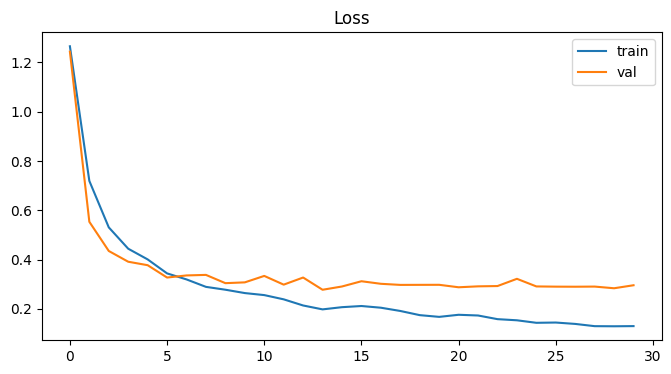

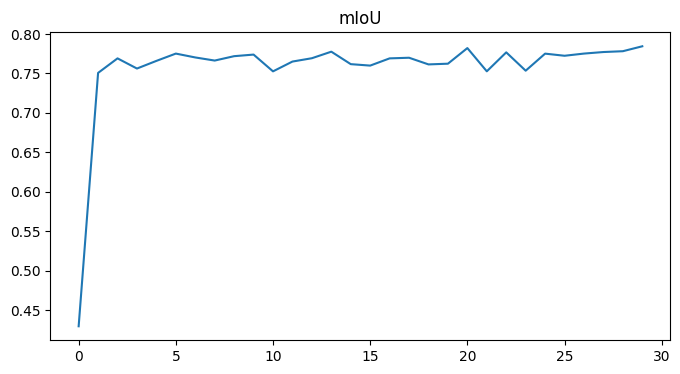

Loaded best: /content/drive/MyDrive/DeepLab_Corrected_Output/deeplab_best_corrected.pth


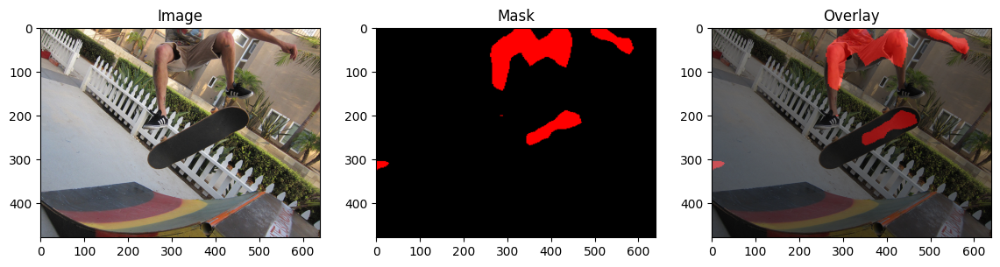

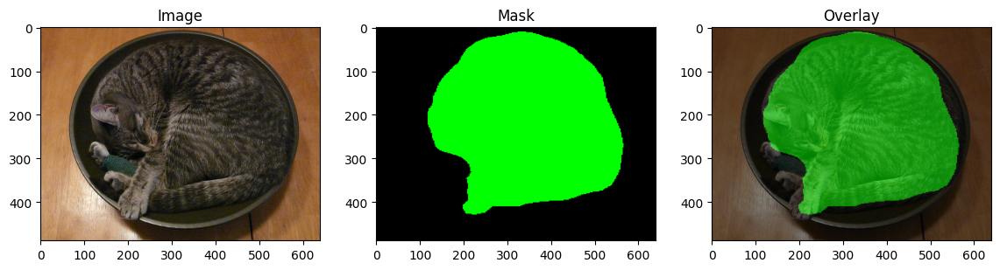

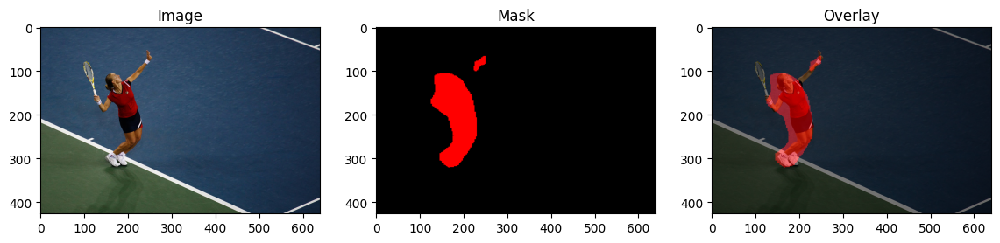

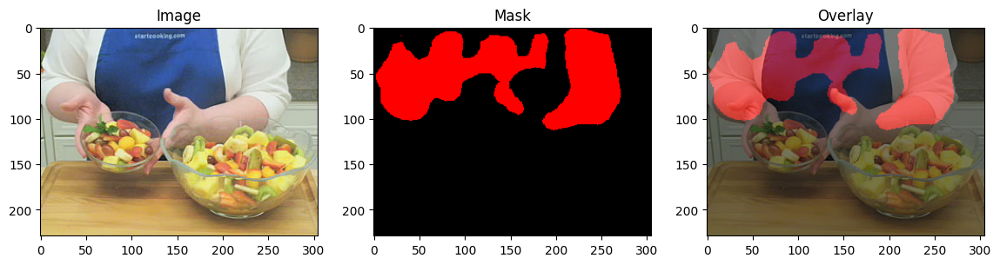

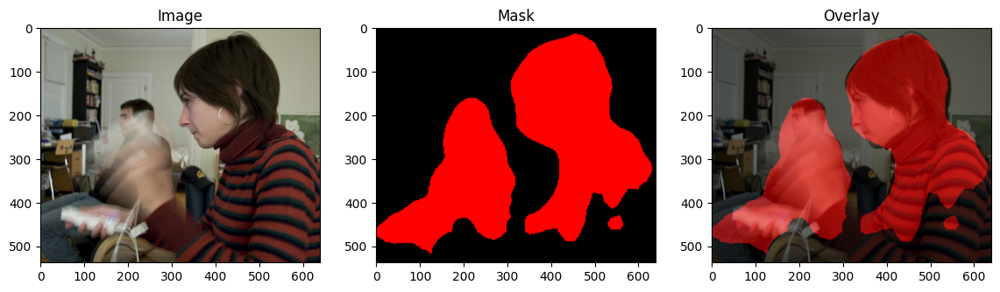

Done.


In [ ]:

import os
import json
from glob import glob
from tqdm import tqdm

import cv2
import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim

from pycocotools.coco import COCO

# SMP and albumentations
import segmentation_models_pytorch as smp
import albumentations as A
from albumentations.pytorch import ToTensorV2


# Config / Hyperparameters
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print("Device:", DEVICE)

# image resize
IMG_SIZE = 256
IMG_HEIGHT = IMG_WIDTH = IMG_SIZE
BATCH_SIZE = 8
LR = 1e-4
EPOCHS = 30
NUM_WORKERS = 4
PIN_MEMORY = True
SAVE_DIR = "/content/drive/MyDrive/DeepLab_Corrected_Output"
os.makedirs(SAVE_DIR, exist_ok=True)

# Paths (update these if your drive path differs)
TRAIN_IMAGES_DIR = "/content/dataset/train-300/data"
VAL_IMAGES_DIR   = "/content/dataset/validation-300/data"
TEST_IMAGES_DIR  = "/content/dataset/test-30"

TRAIN_JSON = "/content/dataset/train-300/labels.json"
VAL_JSON   = "/content/dataset/validation-300/labels.json"

# NOTE: keep NUM_CLASSES = 5 (background + 4 classes)
NUM_CLASSES = 5

# Colors for visualization (background, person, cat, sports ball, book)
CLASS_COLORS = {
    0: (0, 0, 0),
    1: (255, 0, 0),
    2: (0, 255, 0),
    3: (0, 0, 255),
    4: (255, 255, 0)
}

COCO_TO_CLASS = {
    1: 1,
    17: 2,
    37: 3,
    84: 4
}


# Augmentations

train_transform = A.Compose([
    A.Resize(IMG_HEIGHT, IMG_WIDTH),
    A.HorizontalFlip(p=0.5),
    A.ShiftScaleRotate(shift_limit=0.06, scale_limit=0.1, rotate_limit=10, p=0.5, border_mode=cv2.BORDER_REFLECT),
    A.RandomBrightnessContrast(p=0.5),
    A.GaussNoise(p=0.2),
    A.Normalize(mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225)),
    ToTensorV2()
])

val_transform = A.Compose([
    A.Resize(IMG_HEIGHT, IMG_WIDTH),
    A.Normalize(mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225)),
    ToTensorV2()
])


# Robust Dataset: accepts COCO ids

class COCOSegDataset(Dataset):
    def __init__(self, img_dir, ann_file, transforms, filter_empty=True):
        super().__init__()
        self.img_dir = img_dir
        self.coco = COCO(ann_file)
        self.transforms = transforms

        all_ids = sorted(self.coco.getImgIds())

        # index img_id -> filename
        self.id_to_file = {img['id']: img['file_name'] for img in self.coco.loadImgs(all_ids)}

        # filter: keep only images containing at least 1 target category
        self.img_ids = []
        for img_id in all_ids:
            anns = self.coco.loadAnns(self.coco.getAnnIds(img_id))
            has_target = False
            for a in anns:
                cat_id = a["category_id"]
                # Accept if annotation uses COCO ids mapped in COCO_TO_CLASS
                if cat_id in COCO_TO_CLASS:
                    has_target = True
                    break
                # Accept if annotation already uses compact class ids (0..NUM_CLASSES-1)
                if 0 <= cat_id < NUM_CLASSES:
                    has_target = True
                    break
            if (not filter_empty) or has_target:
                self.img_ids.append(img_id)

    def __len__(self):
        return len(self.img_ids)

    def _resolve_class(self, ann_cat_id):
        """
        Resolve an annotation's category id to model class index (0..NUM_CLASSES-1).
        Supports:
          - already compact class ids (0..NUM_CLASSES-1)
          - COCO original ids via COCO_TO_CLASS mapping
        """
        # direct class id (already compact)
        if 0 <= ann_cat_id < NUM_CLASSES:
            return int(ann_cat_id)
        # mapped COCO id
        if ann_cat_id in COCO_TO_CLASS:
            return int(COCO_TO_CLASS[ann_cat_id])

        fallback_map = {1:1, 17:2, 37:3, 84:4}
        if ann_cat_id in fallback_map:
            return int(fallback_map[ann_cat_id])

        return 0

    def __getitem__(self, idx):
        img_id = self.img_ids[idx]
        file_name = self.id_to_file[img_id]
        fp = os.path.join(self.img_dir, file_name)
        image = cv2.imread(fp)
        if image is None:
            raise FileNotFoundError(f"Image not found: {fp}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        h, w = image.shape[:2]
        mask = np.zeros((h, w), dtype=np.uint8)

        anns = self.coco.loadAnns(self.coco.getAnnIds(img_id))
        for ann in anns:
            ann_mask = self.coco.annToMask(ann)
            if ann_mask is None:
                continue
            cat = ann["category_id"]
            cls = self._resolve_class(cat)
            # assign class index to mask
            mask[ann_mask == 1] = cls



        # apply transforms
        if self.transforms:
            augmented = self.transforms(image=image, mask=mask)
            img_t = augmented['image']
            mask_t = augmented['mask']
            # ensure mask is long tensor HxW
            if isinstance(mask_t, np.ndarray):
                mask_t = torch.from_numpy(mask_t).long()
            else:
                mask_t = mask_t.long()
        else:
            img_resized = cv2.resize(image, (IMG_WIDTH, IMG_HEIGHT), interpolation=cv2.INTER_LINEAR)
            img_norm = img_resized.astype(np.float32)/255.0
            img_t = torch.tensor(np.transpose(img_norm, (2,0,1)), dtype=torch.float32)
            mask_resized = cv2.resize(mask, (IMG_WIDTH, IMG_HEIGHT), interpolation=cv2.INTER_NEAREST)
            mask_t = torch.tensor(mask_resized, dtype=torch.long)

        return img_t, mask_t, file_name

# Build dataloaders

train_ds = COCOSegDataset(TRAIN_IMAGES_DIR, TRAIN_JSON, transforms=train_transform, filter_empty=True)
val_ds   = COCOSegDataset(VAL_IMAGES_DIR, VAL_JSON, transforms=val_transform, filter_empty=True)

print(f"Train images: {len(train_ds)}")
print(f"Val images:   {len(val_ds)}")

train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True,
                          num_workers=NUM_WORKERS, pin_memory=PIN_MEMORY)
val_loader = DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False,
                        num_workers=NUM_WORKERS, pin_memory=PIN_MEMORY)

# Quick debug: check mask value set in a couple of training samples
print("Checking a few training masks for label values (should be subset of 0..4)...")
for i in range(min(5, len(train_ds))):
    _, mask_sample, fname = train_ds[i]
    print(f" - {fname}: unique labels ->", np.unique(mask_sample.numpy()))


# Model DeepLab /training components

model = smp.DeepLabV3(
    encoder_name="resnet50",
    encoder_weights="imagenet",
    in_channels=3,
    classes=NUM_CLASSES,
    activation=None
).to(DEVICE)

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

history = {"train_loss": [], "val_loss": [], "miou": []}

def iou_score(pred, mask, num_classes=NUM_CLASSES):
    pred = pred.flatten()
    mask = mask.flatten()
    iou = []
    for cls in range(num_classes):
        p = pred == cls
        g = mask == cls
        inter = (p & g).sum()
        union = (p | g).sum()
        if union == 0:
            iou.append(1.0)
        else:
            iou.append(inter / (union + 1e-6))
    return np.mean(iou)

best_miou = 0

for epoch in range(1, EPOCHS+1):
    model.train()
    train_loss = 0

    for imgs, masks, _ in train_loader:
        imgs = imgs.to(DEVICE)
        masks = masks.long().to(DEVICE)

        optimizer.zero_grad()
        logits = model(imgs)
        # model returns logits in different shapes depending on SMP; ensure we have [B,C,H,W]
        if isinstance(logits, dict) and "out" in logits:
            logits_out = logits["out"]
        else:
            logits_out = logits
        loss = criterion(logits_out, masks)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

    train_loss /= len(train_loader)

    # validation
    model.eval()
    val_loss = 0
    miou = 0

    with torch.no_grad():
        for imgs, masks, _ in val_loader:
            imgs = imgs.to(DEVICE)
            masks = masks.long().to(DEVICE)
            logits = model(imgs)
            if isinstance(logits, dict) and "out" in logits:
                logits_out = logits["out"]
            else:
                logits_out = logits
            loss = criterion(logits_out, masks)
            val_loss += loss.item()

            preds = torch.argmax(logits_out, dim=1).cpu().numpy()
            gts   = masks.cpu().numpy()

            for p,g in zip(preds, gts):
                miou += iou_score(p,g)

    val_loss /= len(val_loader)
    miou /= len(val_ds)

    history["train_loss"].append(train_loss)
    history["val_loss"].append(val_loss)
    history["miou"].append(miou)

    print(f"Epoch {epoch}/{EPOCHS} - Train: {train_loss:.4f}  Val: {val_loss:.4f}  mIoU: {miou:.3f}")

    if miou > best_miou:
        best_miou = miou
        torch.save(model.state_dict(), f"{SAVE_DIR}/deeplab_best_corrected.pth")
        print("✔ Saved best model")

# Save plots and show
plt.figure(figsize=(8,4)); plt.plot(history["train_loss"], label="train"); plt.plot(history["val_loss"], label="val"); plt.legend(); plt.title("Loss"); plt.savefig(os.path.join(SAVE_DIR, "loss.png")); plt.show()
plt.figure(figsize=(8,4)); plt.plot(history["miou"]); plt.title("mIoU"); plt.savefig(os.path.join(SAVE_DIR, "miou.png")); plt.show()


# Inference example visualise test images

TEST_DIR = TEST_IMAGES_DIR
# load best saved if exists
best_fp = os.path.join(SAVE_DIR, "deeplab_best_corrected.pth")
if os.path.exists(best_fp):
    model.load_state_dict(torch.load(best_fp, map_location=DEVICE))
    print("Loaded best:", best_fp)
else:
    print("No best found, using current weights.")

def visualize(img_path):
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    H,W = img_rgb.shape[:2]

    aug = val_transform(image=img_rgb)
    img_t = aug["image"].unsqueeze(0).to(DEVICE)

    with torch.no_grad():
        logits = model(img_t)
        if isinstance(logits, dict) and "out" in logits:
            logits_out = logits["out"]
        else:
            logits_out = logits
        pred = torch.argmax(logits_out, 1).squeeze().cpu().numpy()

    pred_up = cv2.resize(pred, (W,H), interpolation=cv2.INTER_NEAREST)

    color = np.zeros((H,W,3), dtype=np.uint8)
    for c,col in CLASS_COLORS.items():
        color[pred_up == c] = col

    overlay = (0.5*img_rgb + 0.5*color).astype(np.uint8)

    plt.figure(figsize=(14,5))
    plt.subplot(1,3,1); plt.imshow(img_rgb); plt.title("Image")
    plt.subplot(1,3,2); plt.imshow(color); plt.title("Mask")
    plt.subplot(1,3,3); plt.imshow(overlay); plt.title("Overlay")
    plt.show()

# show up to 5 test images
test_files = glob(f"{TEST_DIR}/*.jpg") + glob(f"{TEST_DIR}/*.png")
for fp in test_files[:5]:
    visualize(fp)

print("Images display.")